# Transformers

Throughout this notebook we rely heavily on HuggingFace's resources available at https://huggingface.co/

Hugging Face, Inc. is an American company that develops tools for building applications using machine learning. It is most notable for its transformers library built for natural language processing applications and its platform that allows users to share machine learning models and datasets.

More in-depth tutorials relating to NLP, and Computer Vision can be found at https://huggingface.co/docs/transformers/index

#### Set logs to errors only

In [1]:
import transformers, datasets

transformers.utils.logging.set_verbosity_error

datasets.logging.CRITICAL
transformers.logging.CRITICAL
transformers.logging.set_verbosity_error()

# Preprocessing

ADD DIAGRAM ILLUSTRATING THIS PROCESS

### Encode Text

In [2]:
from transformers import AutoTokenizer
from datasets import load_dataset

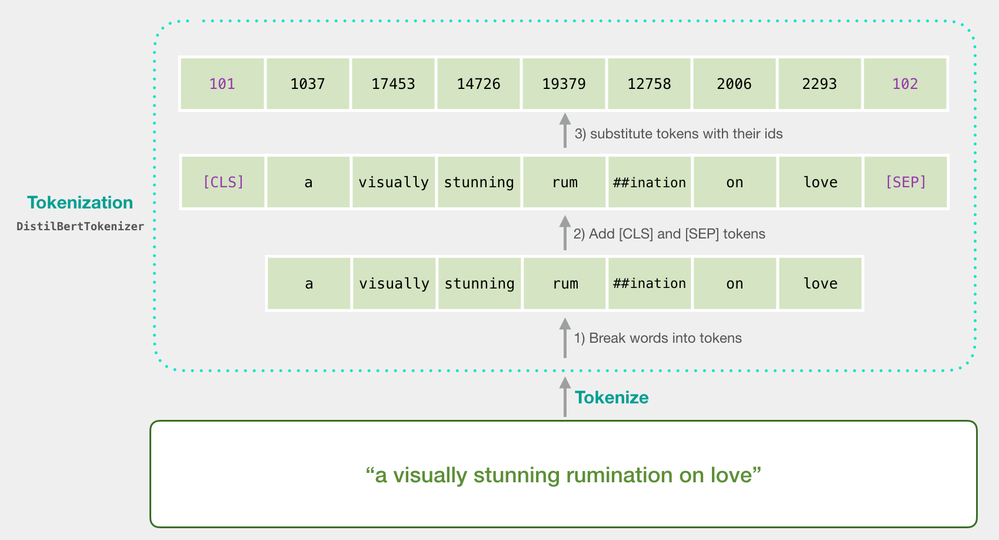

In [3]:
# tokenizer = AutoTokenizer.from_pretrained("bert-base-ucased")

tokenizer = AutoTokenizer.from_pretrained("distilbert-base-uncased")

The tokenizer returns a dictionary with three important items:

    1. input_ids are the indices corresponding to each token in the sentence.
    2. attention_mask indicates whether a token should be attended to or not.


In [4]:
encoded_input = tokenizer("a visually stunning rumination on love")

In [5]:
encoded_input

{'input_ids': [101, 1037, 17453, 14726, 19379, 12758, 2006, 2293, 102], 'attention_mask': [1, 1, 1, 1, 1, 1, 1, 1, 1]}

In [6]:
tokenizer.decode(encoded_input["input_ids"])

'[CLS] a visually stunning rumination on love [SEP]'

As you can see, the tokenizer added two special tokens - CLS and SEP (classifier and separator) - to the sentence. Not all models need special tokens, but if they do, the tokenizer automatically adds them for you.

If there are several sentences you want to preprocess, pass them as a list to the tokenizer:

In [7]:
batch_sentences = [
    "But what about second breakfast?",
    "Don't think he knows about second breakfast, Pip.",
    "What about elevensies?",
]

In [8]:
encoded_inputs = tokenizer(batch_sentences)
encoded_inputs

{'input_ids': [[101, 2021, 2054, 2055, 2117, 6350, 1029, 102], [101, 2123, 1005, 1056, 2228, 2002, 4282, 2055, 2117, 6350, 1010, 28315, 1012, 102], [101, 2054, 2055, 5408, 14625, 1029, 102]], 'attention_mask': [[1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1]]}

In [9]:
tokenizer.vocab

{'better': 2488,
 '##lda': 15150,
 'akin': 17793,
 'waves': 5975,
 '194': 19955,
 'surfer': 27747,
 '[unused288]': 293,
 'henry': 2888,
 'mayor': 3664,
 'regarded': 5240,
 'ensures': 21312,
 '司': 1791,
 'blank': 8744,
 'grateful': 8794,
 'posthumous': 19086,
 '##म': 29867,
 'aeronautics': 27459,
 'reformer': 24767,
 'ₓ': 1563,
 'implement': 10408,
 '##wicz': 21355,
 'dismay': 20006,
 'dispatch': 18365,
 '[unused431]': 436,
 'folks': 12455,
 'drumming': 22980,
 'memo': 24443,
 'truncated': 25449,
 'scrap': 15121,
 'galicia': 19017,
 'implicit': 24655,
 'ᵉ': 1499,
 'unleashed': 22416,
 'sake': 8739,
 'adobe': 18106,
 'heavens': 17223,
 'namibia': 15408,
 'thoughts': 4301,
 '##alis': 13911,
 '##iii': 28954,
 'surface': 3302,
 'psi': 17816,
 '##que': 4226,
 '[unused367]': 372,
 'natalia': 21521,
 'israeli': 5611,
 'macarthur': 17719,
 'rapidly': 5901,
 '⁺': 1544,
 'embarrassed': 10339,
 'fowler': 14990,
 'childish': 24282,
 'appointing': 28050,
 'worlds': 8484,
 '##boot': 27927,
 'refugees

In [10]:
len(tokenizer.vocab)

30522

### Padding

Sentences aren’t always the same length which can be an issue because tensors, the model inputs, need to have a uniform shape. Padding is a strategy for ensuring tensors are rectangular by adding a special padding token to shorter sentences.

Set the padding parameter to True to pad the shorter sequences in the batch to match the longest sequence or the maximum length expected by the model:

In [11]:
batch_sentences = [
    "But what about second breakfast?",
    "Don't think he knows about second breakfast, Pip.",
    "What about elevensies?",
]

In [12]:
encoded_inputs = tokenizer(batch_sentences, padding=True)
encoded_inputs

{'input_ids': [[101, 2021, 2054, 2055, 2117, 6350, 1029, 102, 0, 0, 0, 0, 0, 0], [101, 2123, 1005, 1056, 2228, 2002, 4282, 2055, 2117, 6350, 1010, 28315, 1012, 102], [101, 2054, 2055, 5408, 14625, 1029, 102, 0, 0, 0, 0, 0, 0, 0]], 'attention_mask': [[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]]}

The first and third sentences are now padded with 0’s because they are shorter.

### Truncation

On the other end of the spectrum, sometimes a sequence may be too long for a model to handle. In this case, you’ll need to truncate the sequence to a shorter length.

Set the truncation parameter to True to truncate a sequence to the maximum length accepted by the model:

In [13]:
batch_sentences = [
    "But what about second breakfast?",
    "Don't think he knows about second breakfast, Pip.",
    "What about elevensies?",
]

In [14]:
encoded_inputs = tokenizer(batch_sentences, padding=True, truncation=True)
encoded_inputs

{'input_ids': [[101, 2021, 2054, 2055, 2117, 6350, 1029, 102, 0, 0, 0, 0, 0, 0], [101, 2123, 1005, 1056, 2228, 2002, 4282, 2055, 2117, 6350, 1010, 28315, 1012, 102], [101, 2054, 2055, 5408, 14625, 1029, 102, 0, 0, 0, 0, 0, 0, 0]], 'attention_mask': [[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]]}

### Return as tensors

In [15]:
batch_sentences = [
    "But what about second breakfast?",
    "Don't think he knows about second breakfast, Pip.",
    "What about elevensies?",
]

In [16]:
encoded_inputs = tokenizer(batch_sentences, padding=True, truncation=True, return_tensors="pt")
encoded_inputs

{'input_ids': tensor([[  101,  2021,  2054,  2055,  2117,  6350,  1029,   102,     0,     0,
             0,     0,     0,     0],
        [  101,  2123,  1005,  1056,  2228,  2002,  4282,  2055,  2117,  6350,
          1010, 28315,  1012,   102],
        [  101,  2054,  2055,  5408, 14625,  1029,   102,     0,     0,     0,
             0,     0,     0,     0]]), 'attention_mask': tensor([[1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0],
        [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]])}

# Text Classification

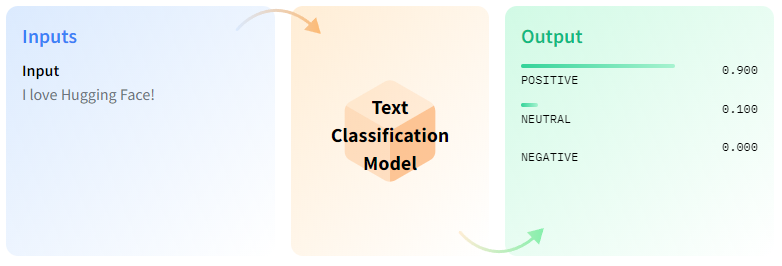

We are going to fine-tune a pre-trained DistilBERT model for text classification. More details about DistilBERT model can be found here https://huggingface.co/docs/transformers/model_doc/distilbert. 

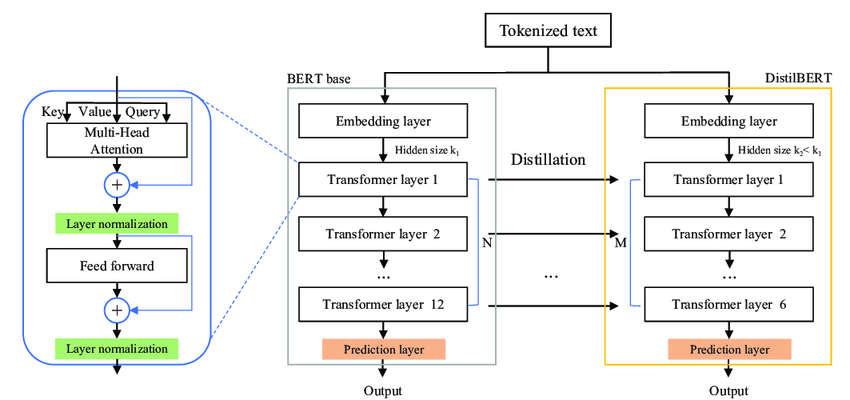

Simple overview of the training pipeline

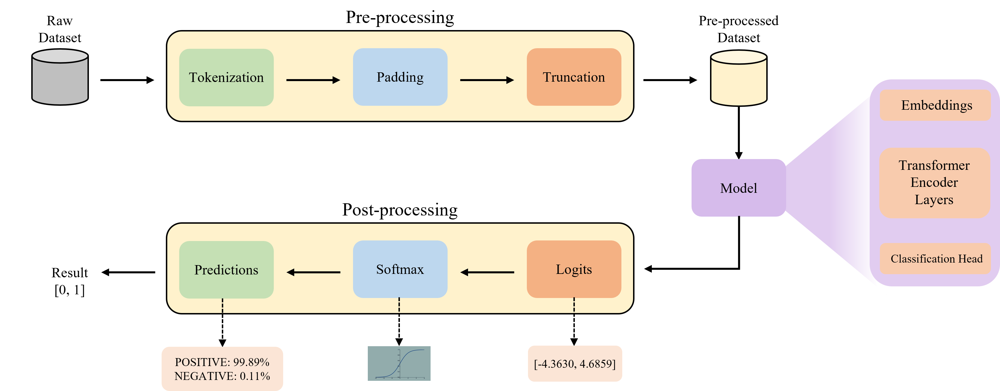

### Dataset

In [17]:
# IMDB movie reviews dataset for sentiment classification 
imdb = load_dataset("imdb")

Found cached dataset imdb (C:/Users/sohail/.cache/huggingface/datasets/imdb/plain_text/1.0.0/d613c88cf8fa3bab83b4ded3713f1f74830d1100e171db75bbddb80b3345c9c0)


  0%|          | 0/3 [00:00<?, ?it/s]

In [18]:
imdb["test"][0]
{
    "label": 0,
    "text": "I love sci-fi and am willing to put up with a lot. Sci-fi movies/TV are usually underfunded, under-appreciated and misunderstood. I tried to like this, I really did, but it is to good TV sci-fi as Babylon 5 is to Star Trek (the original). Silly prosthetics, cheap cardboard sets, stilted dialogues, CG that doesn't match the background, and painfully one-dimensional characters cannot be overcome with a 'sci-fi' setting. (I'm sure there are those of you out there who think Babylon 5 is good sci-fi TV. It's not. It's clichéd and uninspiring.) While US viewers might like emotion and character development, sci-fi is a genre that does not take itself seriously (cf. Star Trek). It may treat important issues, yet not as a serious philosophy. It's really difficult to care about the characters here as they are not simply foolish, just missing a spark of life. Their actions and reactions are wooden and predictable, often painful to watch. The makers of Earth KNOW it's rubbish as they have to always say \"Gene Roddenberry's Earth...\" otherwise people would not continue watching. Roddenberry's ashes must be turning in their orbit as this dull, cheap, poorly edited (watching it without advert breaks really brings this home) trudging Trabant of a show lumbers into space. Spoiler. So, kill off a main character. And then bring him back as another actor. Jeeez! Dallas all over again.",
}

{'label': 0,
 'text': 'I love sci-fi and am willing to put up with a lot. Sci-fi movies/TV are usually underfunded, under-appreciated and misunderstood. I tried to like this, I really did, but it is to good TV sci-fi as Babylon 5 is to Star Trek (the original). Silly prosthetics, cheap cardboard sets, stilted dialogues, CG that doesn\'t match the background, and painfully one-dimensional characters cannot be overcome with a \'sci-fi\' setting. (I\'m sure there are those of you out there who think Babylon 5 is good sci-fi TV. It\'s not. It\'s clichéd and uninspiring.) While US viewers might like emotion and character development, sci-fi is a genre that does not take itself seriously (cf. Star Trek). It may treat important issues, yet not as a serious philosophy. It\'s really difficult to care about the characters here as they are not simply foolish, just missing a spark of life. Their actions and reactions are wooden and predictable, often painful to watch. The makers of Earth KNOW it\'

### Preprocess

In [147]:
tokenizer = AutoTokenizer.from_pretrained("distilbert-base-uncased")


In [149]:
tokenizer.vocab['love']

2293

In [22]:
def preprocess_function(examples):
    return tokenizer(examples["text"], truncation=True)

To apply the preprocessing function over the entire dataset, use 🤗 Datasets map function. You can speed up map by setting batched=True to process multiple elements of the dataset at once:

In [23]:
tokenized_imdb = imdb.map(preprocess_function, batched=True)

Loading cached processed dataset at C:\Users\sohail\.cache\huggingface\datasets\imdb\plain_text\1.0.0\d613c88cf8fa3bab83b4ded3713f1f74830d1100e171db75bbddb80b3345c9c0\cache-84383285c97ffb4a.arrow


  0%|          | 0/25 [00:00<?, ?ba/s]

Loading cached processed dataset at C:\Users\sohail\.cache\huggingface\datasets\imdb\plain_text\1.0.0\d613c88cf8fa3bab83b4ded3713f1f74830d1100e171db75bbddb80b3345c9c0\cache-4892581a2722526d.arrow


In [75]:
tokenized_imdb['test']

Dataset({
    features: ['text', 'label', 'input_ids', 'attention_mask'],
    num_rows: 25000
})

In [160]:
tokenized_imdb['test']['input_ids']

[[101,
  1045,
  2293,
  16596,
  1011,
  10882,
  1998,
  2572,
  5627,
  2000,
  2404,
  2039,
  2007,
  1037,
  2843,
  1012,
  16596,
  1011,
  10882,
  5691,
  1013,
  2694,
  2024,
  2788,
  2104,
  11263,
  25848,
  1010,
  2104,
  1011,
  12315,
  1998,
  28947,
  1012,
  1045,
  2699,
  2000,
  2066,
  2023,
  1010,
  1045,
  2428,
  2106,
  1010,
  2021,
  2009,
  2003,
  2000,
  2204,
  2694,
  16596,
  1011,
  10882,
  2004,
  17690,
  1019,
  2003,
  2000,
  2732,
  10313,
  1006,
  1996,
  2434,
  1007,
  1012,
  10021,
  4013,
  3367,
  20086,
  2015,
  1010,
  10036,
  19747,
  4520,
  1010,
  25931,
  3064,
  22580,
  1010,
  1039,
  2290,
  2008,
  2987,
  1005,
  1056,
  2674,
  1996,
  4281,
  1010,
  1998,
  16267,
  2028,
  1011,
  8789,
  3494,
  3685,
  2022,
  9462,
  2007,
  1037,
  1005,
  16596,
  1011,
  10882,
  1005,
  4292,
  1012,
  1006,
  1045,
  1005,
  1049,
  2469,
  2045,
  2024,
  2216,
  1997,
  2017,
  2041,
  2045,
  2040,
  2228,
  17690,
  1

Now create a batch of examples using DataCollatorWithPadding. It’s more efficient to dynamically pad the sentences to the longest length in a batch during collation, instead of padding the whole dataset to the maximum length.

In [30]:
from transformers import DataCollatorWithPadding

data_collator = DataCollatorWithPadding(tokenizer=tokenizer)

### Evaluate

Including a metric during training is often helpful for evaluating your model’s performance. You can quickly load a evaluation method with the 🤗 Evaluate library. For this task, load the accuracy metric (see the 🤗 Evaluate quick tour to learn more about how to load and compute a metric):

In [33]:
import evaluate

accuracy = evaluate.load("accuracy")


Then create a function that passes your predictions and labels to compute to calculate the accuracy:

In [34]:
import numpy as np

def compute_metrics(eval_pred):
    
    predictions, labels = eval_pred
    predictions = np.argmax(predictions, axis=1)
    
    return accuracy.compute(predictions=predictions, references=labels)

Your compute_metrics function is ready to go now, and you’ll return to it when you setup your training.

### Train

Before you start training your model, create a map of the expected ids to their labels with id2label and label2id:

In [35]:
id2label = {0: "NEGATIVE", 1: "POSITIVE"}
label2id = {"NEGATIVE": 0, "POSITIVE": 1}

You’re ready to start training your model now! Load DistilBERT with AutoModelForSequenceClassification along with the number of expected labels, and the label mappings:

In [36]:
from transformers import AutoModelForSequenceClassification, TrainingArguments, Trainer

model = AutoModelForSequenceClassification.from_pretrained(
    "distilbert-base-uncased", num_labels=2, id2label=id2label, label2id=label2id)

At this point, only three steps remain:

    1. Define your training hyperparameters in TrainingArguments. The only required parameter is output_dir which specifies where to save your model. You’ll push this model to the Hub by setting push_to_hub=True (you need to be signed in to Hugging Face to upload your model). At the end of each epoch, the Trainer will evaluate the accuracy and save the training checkpoint.
    
    2. Pass the training arguments to Trainer along with the model, dataset, tokenizer, data collator, and compute_metrics function.
    
    3. Call train() to finetune your model.

In [37]:
training_args = TrainingArguments(
    output_dir="my_model",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=2,
    weight_decay=0.01,
    evaluation_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    push_to_hub=False,
)

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=tokenized_imdb["train"],
    eval_dataset=tokenized_imdb["test"],
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)


In [38]:
trainer.train()

C:\Users\sohail\anaconda3\envs\python_3_gpss\lib\site-packages\transformers\optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
wandb: Currently logged in as: sakhan2. Use `wandb login --relogin` to force relogin


{'loss': 0.3099, 'learning_rate': 1.6801023672424827e-05, 'epoch': 0.32}
{'loss': 0.2437, 'learning_rate': 1.3602047344849649e-05, 'epoch': 0.64}
{'loss': 0.2338, 'learning_rate': 1.0403071017274472e-05, 'epoch': 0.96}
{'eval_loss': 0.19516132771968842, 'eval_accuracy': 0.925, 'eval_runtime': 260.1151, 'eval_samples_per_second': 96.111, 'eval_steps_per_second': 6.009, 'epoch': 1.0}
{'loss': 0.1612, 'learning_rate': 7.204094689699297e-06, 'epoch': 1.28}
{'loss': 0.1439, 'learning_rate': 4.005118362124121e-06, 'epoch': 1.6}
{'loss': 0.1495, 'learning_rate': 8.061420345489445e-07, 'epoch': 1.92}
{'eval_loss': 0.24084855616092682, 'eval_accuracy': 0.93028, 'eval_runtime': 255.4504, 'eval_samples_per_second': 97.866, 'eval_steps_per_second': 6.119, 'epoch': 2.0}
{'train_runtime': 2027.1311, 'train_samples_per_second': 24.665, 'train_steps_per_second': 1.542, 'train_loss': 0.20415895258243924, 'epoch': 2.0}


TrainOutput(global_step=3126, training_loss=0.20415895258243924, metrics={'train_runtime': 2027.1311, 'train_samples_per_second': 24.665, 'train_steps_per_second': 1.542, 'train_loss': 0.20415895258243924, 'epoch': 2.0})

Save finetuned model

In [64]:
trainer.save_model('text_classifier')

Saving model checkpoint to text_classifier
Configuration saved in text_classifier\config.json
Model weights saved in text_classifier\pytorch_model.bin
tokenizer config file saved in text_classifier\tokenizer_config.json
Special tokens file saved in text_classifier\special_tokens_map.json


### Inference

In [49]:
text = "This was a masterpiece. Not completely faithful to the books, but enthralling from beginning to end. Might be my favorite of the three."

In [50]:
from transformers import pipeline

classifier = pipeline("sentiment-analysis", model="text_classifier/")
classifier(text)

[{'label': 'POSITIVE', 'score': 0.9891782999038696}]

In [161]:
# model

In [163]:
# from transformers import pipeline
# pipeline = pipeline('feature-extraction', model='distilbert-base-uncased')
# data = pipeline(text)
# print((data))

In [32]:
# from transformers import AutoTokenizer

# tokenizer = AutoTokenizer.from_pretrained("text_classifier/")
# inputs = tokenizer(text, return_tensors="pt")

In [33]:
# from transformers import AutoModelForSequenceClassification
# import torch

# model = AutoModelForSequenceClassification.from_pretrained("text_classifier/")
# with torch.no_grad():
#     logits = model(**inputs).logits

In [34]:
# from torch import nn

# softmax_function = nn.Softmax(dim=1)
# output = softmax_function(logits)
# output

tensor([[0.0108, 0.9892]])

In [35]:
# predicted_class_id = logits.argmax().item()
# model.config.id2label[predicted_class_id]

'POSITIVE'

# Language Modelling

A trained language model generates text.

We can optionally pass it some text as input, which influences its output.

The output is generated from what the model “learned” during its training period where it scanned vast amounts of text.

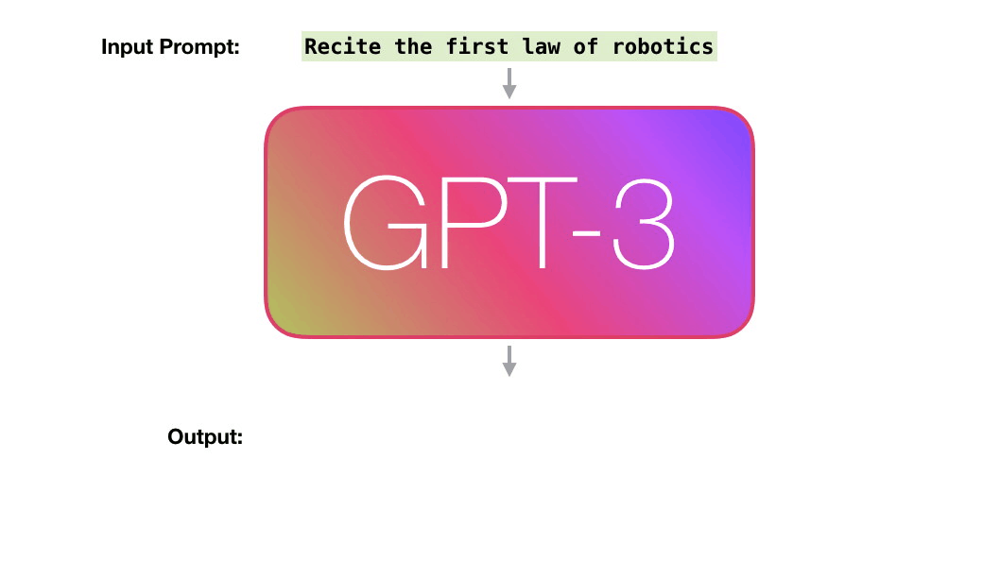

Training is the process of exposing the model to lots of text. That process has been completed. All the experiments you see now are from that one trained model. It was estimated to cost 355 GPU years and cost $4.6m.

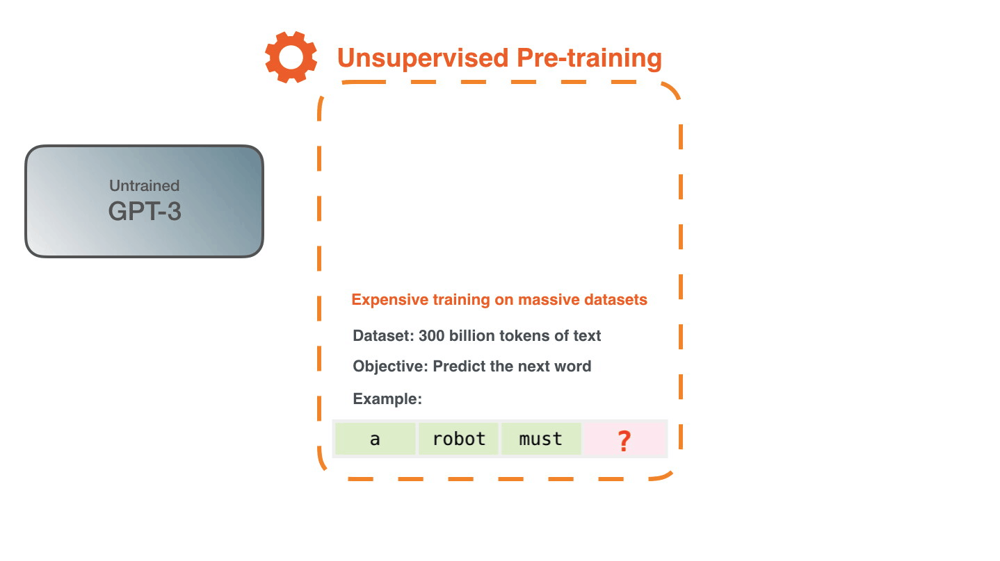

The dataset of 300 billion tokens of text is used to generate training examples for the model. For example, these are three training examples generated from the one sentence at the top.

You can see how you can slide a window across all the text and make lots of examples.

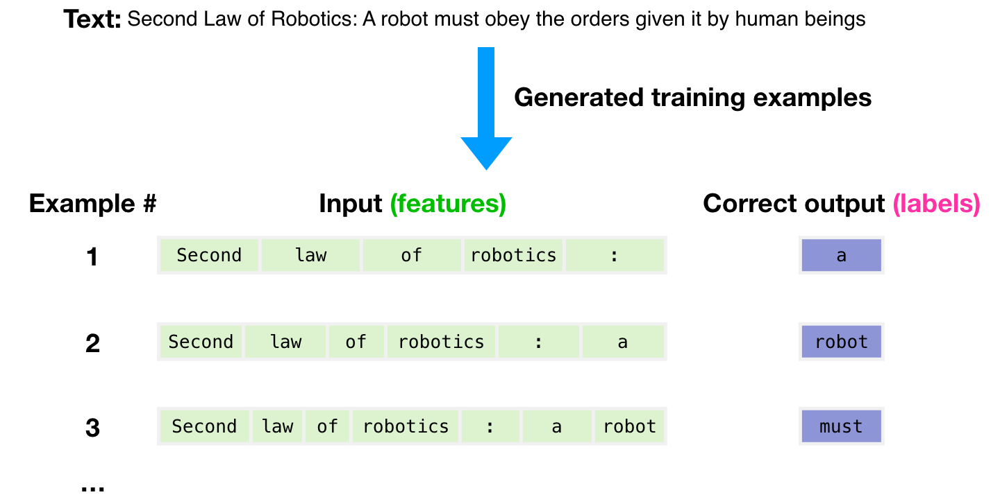

The model is presented with an example. We only show it the features and ask it to predict the next word.

The model’s prediction will be wrong. We calculate the error in its prediction and update the model so next time it makes a better prediction.

Repeat millions of times

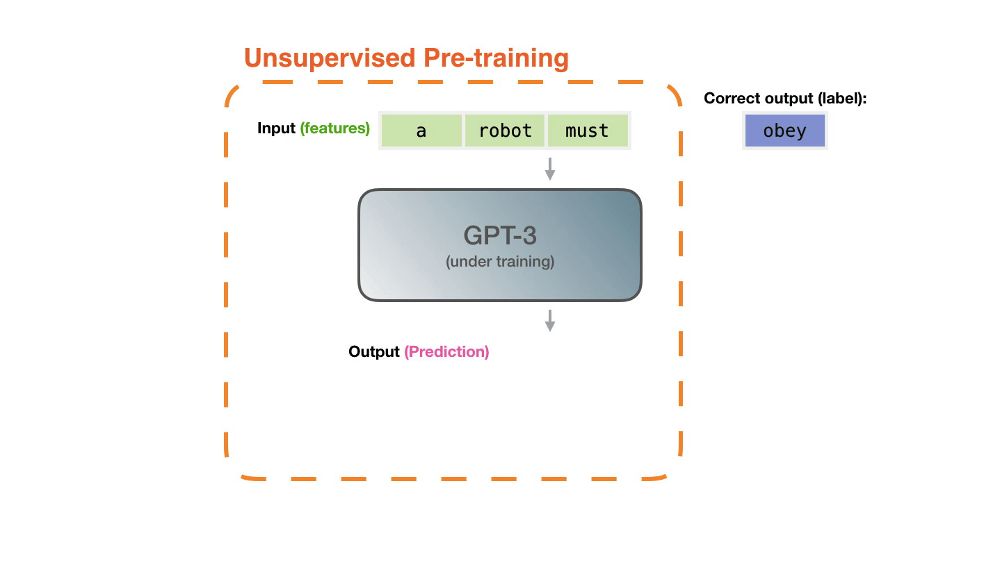

Now let’s look at these same steps with a bit more detail.

GPT3 actually generates output one token at a time (let’s assume a token is a word for now).

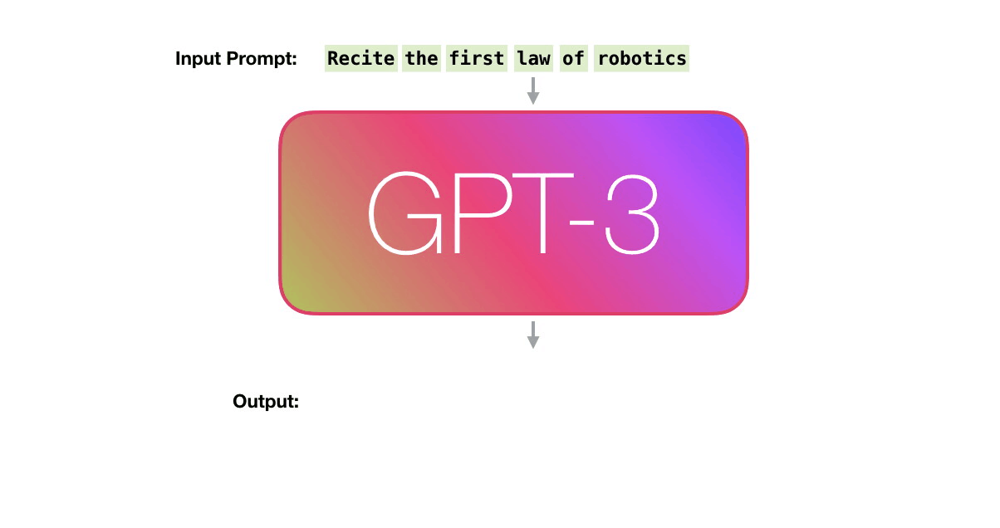

Please note: This is a description of how GPT-3 works and not a discussion of what is novel about it (which is mainly the ridiculously large scale). The architecture is a transformer decoder model based on this paper https://arxiv.org/pdf/1801.10198.pdf

GPT3 is MASSIVE. It encodes what it learns from training in 175 billion numbers (called parameters). These numbers are used to calculate which token to generate at each run.

The untrained model starts with random parameters. Training finds values that lead to better predictions.

### Load ELI5 dataset

Start by loading a smaller subset of the r/askscience subset of the ELI5 dataset from the 🤗 Datasets library. This’ll give you a chance to experiment and make sure everything works before spending more time training on the full dataset.

In [171]:
from datasets import load_dataset

eli5 = load_dataset("eli5", split="train_asks[:5000]")

Found cached dataset eli5 (C:/Users/sohail/.cache/huggingface/datasets/eli5/LFQA_reddit/1.0.0/17574e5502a10f41bbd17beba83e22475b499fa62caa1384a3d093fc856fe6fa)


In [173]:
eli5 = eli5.train_test_split(test_size=0.2)

In [179]:
print('Train samples: ' + str(len(eli5['train'])), '\nTest samples: ' + str(len(eli5['test'])))

Train samples: 4000 
Test samples: 1000


In [180]:
eli5["train"][0]

{'q_id': 't5xj4',
 'title': 'Why is the Rowland circle function needed for Wave Dispersion Spectroscopy?',
 'selftext': "I understand it has something to do with satisfying Bragg's law, but I don't really understand the principle behind it.",
 'document': '',
 'subreddit': 'askscience',
 'answers': {'a_id': ['c4jtq7k'],
  'text': ['In order to maintain the geometry for diffraction, the X-ray source, diffracting crystal, and detector must stay on  the Rowland Circle. As one changes the angle of incidence of X-rays on the crystal (moving the source relative to the crystal), one must also shift the detector position on the Rowland circle. [Here](_URL_0_) is a discussion with a good figure showing this. For microprobes, the detector shifts as the crystal is moved in a linear fashion away from the source, changing the incident angle.'],
  'score': [2]},
 'title_urls': {'url': []},
 'selftext_urls': {'url': []},
 'answers_urls': {'url': ['http://www4.nau.edu/microanalysis/Microprobe-SEM/Sign

While this may look like a lot, you’re only really interested in the text field. What’s cool about language modeling tasks is you don’t need labels (also known as an unsupervised task) because the next word is the label.

You’ll notice from the example above, the text field is actually nested inside answers. This means you’ll need to extract the text subfield from its nested structure with the flatten method:

In [181]:
eli5 = eli5.flatten()
eli5["train"][0]

{'q_id': 't5xj4',
 'title': 'Why is the Rowland circle function needed for Wave Dispersion Spectroscopy?',
 'selftext': "I understand it has something to do with satisfying Bragg's law, but I don't really understand the principle behind it.",
 'document': '',
 'subreddit': 'askscience',
 'answers.a_id': ['c4jtq7k'],
 'answers.text': ['In order to maintain the geometry for diffraction, the X-ray source, diffracting crystal, and detector must stay on  the Rowland Circle. As one changes the angle of incidence of X-rays on the crystal (moving the source relative to the crystal), one must also shift the detector position on the Rowland circle. [Here](_URL_0_) is a discussion with a good figure showing this. For microprobes, the detector shifts as the crystal is moved in a linear fashion away from the source, changing the incident angle.'],
 'answers.score': [2],
 'title_urls.url': [],
 'selftext_urls.url': [],
 'answers_urls.url': ['http://www4.nau.edu/microanalysis/Microprobe-SEM/Signal_De

Each subfield is now a separate column as indicated by the answers prefix, and the text field is a list now. Instead of tokenizing each sentence separately, convert the list to a string so you can jointly tokenize them.

Here is a first preprocessing function to join the list of strings for each example and tokenize the result:

### Preprocess

In [226]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("distilgpt2")

In [227]:
def preprocess_function(examples):
    return tokenizer([" ".join(x) for x in examples["answers.text"]])


To apply this preprocessing function over the entire dataset, use the 🤗 Datasets map method. You can speed up the map function by setting batched=True to process multiple elements of the dataset at once, and increasing the number of processes with num_proc. Remove any columns you don’t need:

In [228]:
tokenized_eli5 = eli5.map(
    preprocess_function,
    batched=True,
    remove_columns=eli5["train"].column_names,
)

Loading cached processed dataset at C:\Users\sohail\.cache\huggingface\datasets\eli5\LFQA_reddit\1.0.0\17574e5502a10f41bbd17beba83e22475b499fa62caa1384a3d093fc856fe6fa\cache-0d720f4d8049373a.arrow


  0%|          | 0/1 [00:00<?, ?ba/s]

In [229]:
tokenized_eli5

DatasetDict({
    train: Dataset({
        features: ['input_ids', 'attention_mask'],
        num_rows: 4000
    })
    test: Dataset({
        features: ['input_ids', 'attention_mask'],
        num_rows: 1000
    })
})

This dataset contains the token sequences, but some of these are longer than the maximum input length for the model.

You can now use a second preprocessing function to

    concatenate all the sequences

    split the concatenated sequences into shorter chunks defined by block_size, which should be both shorter than the maximum input length and short enough for your GPU RAM.

In [230]:
block_size = 128

def group_texts(examples):
    # Concatenate all texts.
    concatenated_examples = {k: sum(examples[k], []) for k in examples.keys()}
    total_length = len(concatenated_examples[list(examples.keys())[0]])
    # We drop the small remainder, we could add padding if the model supported it instead of this drop, you can
    # customize this part to your needs.
    if total_length >= block_size:
        total_length = (total_length // block_size) * block_size
    # Split by chunks of block_size.
    result = {
        k: [t[i : i + block_size] for i in range(0, total_length, block_size)]
        for k, t in concatenated_examples.items()
    }
    result["labels"] = result["input_ids"].copy()
    return result

Apply the group_texts function over the entire dataset:


In [231]:
lm_dataset = tokenized_eli5.map(group_texts, batched=True)


  0%|          | 0/4 [00:00<?, ?ba/s]

  0%|          | 0/1 [00:00<?, ?ba/s]

In [232]:
lm_dataset['train']['input_ids']

[[818,
  1502,
  284,
  5529,
  262,
  22939,
  329,
  814,
  7861,
  11,
  262,
  1395,
  12,
  2433,
  2723,
  11,
  814,
  974,
  278,
  15121,
  11,
  290,
  31029,
  1276,
  2652,
  319,
  220,
  262,
  11314,
  1044,
  16291,
  13,
  1081,
  530,
  2458,
  262,
  9848,
  286,
  18349,
  286,
  1395,
  12,
  20477,
  319,
  262,
  15121,
  357,
  31462,
  262,
  2723,
  3585,
  284,
  262,
  15121,
  828,
  530,
  1276,
  635,
  6482,
  262,
  31029,
  2292,
  319,
  262,
  11314,
  1044,
  9197,
  13,
  685,
  4342,
  16151,
  62,
  21886,
  62,
  15,
  62,
  8,
  318,
  257,
  5114,
  351,
  257,
  922,
  3785,
  4478,
  428,
  13,
  1114,
  4580,
  1676,
  12636,
  11,
  262,
  31029,
  15381,
  355,
  262,
  15121,
  318,
  3888,
  287,
  257,
  14174,
  6977,
  1497,
  422,
  262,
  2723,
  11,
  5609,
  262,
  4519,
  9848,
  13,
  6943,
  2208,
  330,
  2340,
  389,
  30329,
  425,
  13,
  8673,
  345,
  821,
  3612,
  546,
  1097],
 [2865,
  1531,
  7408,
  11,
  543,
  31

In [233]:
from transformers import DataCollatorForLanguageModeling

tokenizer.pad_token = tokenizer.eos_token
data_collator = DataCollatorForLanguageModeling(tokenizer=tokenizer, mlm=False)

In [234]:
from transformers import AutoModelForCausalLM, TrainingArguments, Trainer

model = AutoModelForCausalLM.from_pretrained("distilgpt2")

In [235]:
training_args = TrainingArguments(
    output_dir="eli5_clm_model",
    evaluation_strategy="epoch",
    learning_rate=2e-5,
    weight_decay=0.01,
#     push_to_hub=True,
)

trainer = Trainer(
    model=model,
    args=training_args,
    tokenizer=tokenizer,
    train_dataset=lm_dataset["train"],
    eval_dataset=lm_dataset["test"],
    data_collator=data_collator,
)


In [112]:
trainer.train()

C:\Users\sohail\anaconda3\envs\python_3_gpss\lib\site-packages\transformers\optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


{'loss': 3.6876, 'learning_rate': 1.7057958223006767e-05, 'epoch': 0.44}
{'loss': 3.7143, 'learning_rate': 1.4115916446013535e-05, 'epoch': 0.88}
{'eval_loss': 3.730862617492676, 'eval_runtime': 10.0822, 'eval_samples_per_second': 220.091, 'eval_steps_per_second': 27.573, 'epoch': 1.0}
{'loss': 3.6667, 'learning_rate': 1.1173874669020302e-05, 'epoch': 1.32}
{'loss': 3.6512, 'learning_rate': 8.231832892027067e-06, 'epoch': 1.77}
{'eval_loss': 3.728694200515747, 'eval_runtime': 10.078, 'eval_samples_per_second': 220.183, 'eval_steps_per_second': 27.585, 'epoch': 2.0}
{'loss': 3.6334, 'learning_rate': 5.2897911150338345e-06, 'epoch': 2.21}
{'loss': 3.6249, 'learning_rate': 2.3477493380406004e-06, 'epoch': 2.65}
{'eval_loss': 3.726794958114624, 'eval_runtime': 10.0667, 'eval_samples_per_second': 220.43, 'eval_steps_per_second': 27.616, 'epoch': 3.0}
{'train_runtime': 493.6715, 'train_samples_per_second': 55.045, 'train_steps_per_second': 6.885, 'train_loss': 3.6603094574001545, 'epoch': 3.

TrainOutput(global_step=3399, training_loss=3.6603094574001545, metrics={'train_runtime': 493.6715, 'train_samples_per_second': 55.045, 'train_steps_per_second': 6.885, 'train_loss': 3.6603094574001545, 'epoch': 3.0})

In [113]:
import math

eval_results = trainer.evaluate()
print(f"Perplexity: {math.exp(eval_results['eval_loss']):.2f}")

{'eval_loss': 3.726794958114624, 'eval_runtime': 10.023, 'eval_samples_per_second': 221.391, 'eval_steps_per_second': 27.736, 'epoch': 3.0}
Perplexity: 41.55


In [114]:
trainer.save_model('eli5_clm_model')

### Inference

In [277]:
prompt = "The Shawshank"

In [278]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("distilgpt2")
inputs = tokenizer(prompt, return_tensors="pt").input_ids

In [288]:
from transformers import AutoModelForCausalLM

model = AutoModelForCausalLM.from_pretrained("distilgpt2")
outputs = model.generate(inputs, max_new_tokens=2, do_sample=False)

In [289]:
tokenizer.batch_decode(outputs, skip_special_tokens=True)

['The Shawshank Redemption)']